<a href="https://colab.research.google.com/github/almaksimova/Bachelor-thesis/blob/main/Bachelor_thesis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

 **Федеральное государственное образовательное бюджетное
учреждение высшего профессионального образования**
##### **«Финансовый университет при Правительстве Российской Федерации»**

«Департамент анализа данных, принятия решений и финансовых технологий»


Выпускная квалификационная работа на тему:

#####**«Разработка системы распознавания пользовательских отзывов на основе методов машинного обучения»**





#####Выполнила:
#####Студенка группы ПМ18-2 
#####факультета «Информационных технологий и анализа больших данных»
#####Максимова А.О.

#####Научный руководитель:
#####д.э.н. Демин И.С.

#Загрузка библиотек

In [ ]:
!pip install -U spacy==3.2.0

     |████████████████████████████████| 6.0 MB 4.9 MB/s 
     |████████████████████████████████| 457 kB 29.7 MB/s 
     |████████████████████████████████| 181 kB 26.7 MB/s 
     |████████████████████████████████| 42 kB 1.2 MB/s 
     |████████████████████████████████| 653 kB 31.8 MB/s 
     |████████████████████████████████| 10.1 MB 29.6 MB/s 
     |████████████████████████████████| 58 kB 5.1 MB/s 
  Attempting uninstall: typing-extensions
    Found existing installation: typing-extensions 4.2.0
    Uninstalling typing-extensions-4.2.0:
      Successfully uninstalled typing-extensions-4.2.0
  Attempting uninstall: catalogue
    Found existing installation: catalogue 1.0.0
    Uninstalling catalogue-1.0.0:
      Successfully uninstalled catalogue-1.0.0
  Attempting uninstall: srsly
    Found existing installation: srsly 1.0.5
    Uninstalling srsly-1.0.5:
      Successfully uninstalled srsly-1.0.5
  Attempting uninstall: smart-open
    Found existing installation: smart-open 6.0.0
    U

In [ ]:
!pip install umap-learn

     |████████████████████████████████| 88 kB 2.0 MB/s 
     |████████████████████████████████| 1.1 MB 30.3 MB/s 
  Created wheel for umap-learn: filename=umap_learn-0.5.3-py3-none-any.whl size=82829 sha256=c5801a686c9830ace7de3436f60296a95eb19904f82f0cc2573431ecfced674b
  Stored in directory: /root/.cache/pip/wheels/b3/52/a5/1fd9e3e76a7ab34f134c07469cd6f16e27ef3a37aeff1fe821
  Created wheel for pynndescent: filename=pynndescent-0.5.7-py3-none-any.whl size=54286 sha256=eedc99b897b2095f703cb7809eace029ac2318232d71c40a6569a60e1fce0238
  Stored in directory: /root/.cache/pip/wheels/7f/2a/f8/7bd5dcec71bd5c669f6f574db3113513696b98f3f9b51f496c
Successfully built umap-learn pynndescent


In [ ]:
!pip install scattertext

     |████████████████████████████████| 7.3 MB 3.8 MB/s 
     |████████████████████████████████| 24.1 MB 1.5 MB/s 
  Created wheel for flashtext: filename=flashtext-2.7-py2.py3-none-any.whl size=9309 sha256=76c4f1c12e2d41313a3fa5454edfb57b381e0a25b11210b27f45028b909681d8
  Stored in directory: /root/.cache/pip/wheels/cb/19/58/4e8fdd0009a7f89dbce3c18fff2e0d0fa201d5cdfd16f113b7
Successfully built flashtext
  Attempting uninstall: gensim
    Found existing installation: gensim 3.6.0
    Uninstalling gensim-3.6.0:
      Successfully uninstalled gensim-3.6.0


In [ ]:
import pandas as pd
import spacy
from spacy import displacy
import time
import re
import plotly.express as px
from sklearn.manifold import TSNE
import umap.umap_ as umap
from sklearn.cluster import KMeans
from sklearn.feature_extraction.text import TfidfVectorizer

import plotly.graph_objects as go
from plotly.subplots import make_subplots

import numpy as np


import matplotlib.pyplot as plt
%matplotlib inline 

import scattertext as st

from tqdm._tqdm_notebook import tqdm_notebook

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.*` instead of `tqdm._tqdm_notebook.*`


In [ ]:
spacy.__version__

'3.2.0'

In [ ]:
!python -m spacy download ru_core_news_md

     |████████████████████████████████| 43.0 MB 26.4 MB/s 
     |████████████████████████████████| 55 kB 2.0 MB/s 
     |████████████████████████████████| 8.2 MB 5.9 MB/s 
✔ Download and installation successful
You can now load the package via spacy.load('ru_core_news_md')


#Предобработка 

In [ ]:
spacy_ru = spacy.load('ru_core_news_md')

## spacy

In [ ]:
doc = spacy_ru('Меня зовут Саша и я пишу дипломную работу для Финансового Университета в Москве')

cols = ("text", "lemma", "POS", "explain", "stopword")
rows = []

for t in doc:
    row = [t.text, t.lemma_, t.pos_, spacy.explain(t.pos_), t.is_stop]
    rows.append(row)

df = pd.DataFrame(rows, columns=cols) 
df

,text,lemma,POS,explain,stopword
0,Меня,меня,PRON,pronoun,True
1,зовут,звать,VERB,verb,False
2,Саша,саша,PROPN,proper noun,False
3,и,и,CCONJ,coordinating conjunction,True
4,я,я,PRON,pronoun,True
5,пишу,писать,VERB,verb,False
6,дипломную,дипломный,ADJ,adjective,False
7,работу,работа,NOUN,noun,False
8,для,для,ADP,adposition,True
9,Финансового,финансовый,ADJ,adjective,False


In [ ]:
displacy.render(doc, style="ent", jupyter=True)

In [ ]:
for ent in doc.ents:
    print(ent.text, ent.start_char, ent.end_char, ent.label_)

Саша 11 15 PER
Финансового Университета 46 70 ORG
Москве 73 79 LOC


In [ ]:
displacy.render(doc, style="dep", jupyter=True)

In [ ]:
def tokenize_ru(text):
    """
    Tokenizes Russian text from a string into a list of strings
    """
    return [tok.text for tok in spacy_ru.tokenizer(text)]

In [ ]:
doc

Меня зовут Саша и я пишу дипломную работу для Финансового Университета в Москве

In [ ]:
tokenize_ru(str(doc))

['Меня',
 'зовут',
 'Саша',
 'и',
 'я',
 'пишу',
 'дипломную',
 'работу',
 'для',
 'Финансового',
 'Университета',
 'в',
 'Москве']

## reviews

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
reviews1 = pd.read_excel('/content/drive/My Drive/Study/8th semester/Bachelor thesis/ozon_brands_reviews_review_list_2022_04_27_19_07.xlsx')
reviews2 = pd.read_excel('/content/drive/My Drive/Study/8th semester/Bachelor thesis/ozon_brands_reviews_review_list_2022_04_27_19_08.xlsx')
reviews = pd.concat([reviews1,reviews2])

In [ ]:
# reviews1 = pd.read_excel("ozon_brands_reviews_review_list_2022_04_27_19_07.xlsx")
# reviews2 = pd.read_excel("ozon_brands_reviews_review_list_2022_04_27_19_08.xlsx")
# reviews = pd.concat([reviews1,reviews2])

In [ ]:
reviews = reviews.sample(frac=1).reset_index(drop=True)
reviews.head()

,Фото,Продукт,Статус,Бренд,ID Ритейлера,Ссылка,Магазин,Категория,Рейтинг отзыва,Страна,MPN / Код вендора,Комментарий,Кол-во ответов,Дата последнего ответа,Тексты ответов,Дата отзыва
0,https://cdn1.ozone.ru/s3/multimedia-v/60023945...,Робот-пылесос Tefal X-plorer Serie 20 RG6875...,Available,Tefal,159733810,https://www.ozon.ru/context/detail/id/159733810/,OZON Express,"Бытовая техника, Техника для дома, Пылесосы и ...",5.0,NaN,RG6875WH,NaN,1,2022-04-01 09:23:30,NaN,2022-03-30 13:09:27
1,https://cdn1.ozone.ru/s3/multimedia-0/60692646...,Робот-пылесос Xiaomi Mi Robot Vacuum Mop RU ...,Out of stock,Xiaomi,170864208,https://www.ozon.ru/context/detail/id/170864208/,OZON,"Бытовая техника, Техника для дома, Пылесосы и ...",1.0,NaN,X25012,Комментарий: Оформила возврат. \nСначала было ...,0,NaN,NaN,2022-04-09 10:54:04
2,https://cdn1.ozone.ru/s3/multimedia-s/60768498...,"Робот-пылесос REDMOND RV-R650S, черный",Available,REDMOND,190217920,https://www.ozon.ru/context/detail/id/190217920/,OZON fresh,"Бытовая техника, Техника для дома, Пылесосы и ...",2.0,NaN,RV-R650S,Комментарий: Месяц стоял на базе и после включ...,0,NaN,NaN,2021-10-27 20:58:35
3,https://cdn1.ozone.ru/s3/multimedia-z/60679812...,Вертикальный пылесос DEERMA DX700,Available,Лучшая цена на Ozon,420278994,https://www.ozon.ru/context/detail/id/420278994/,NEW WAVE,"Бытовая техника, Техника для дома, Пылесосы и ...",5.0,NaN,NaN,"Комментарий: В целом, со своей функцией справл...",1,2022-04-21 09:04:31,Здравствуйте. Благодарим за покупку и оставлен...,2022-04-20 22:24:47
4,https://cdn1.ozone.ru/s3/multimedia-8/60093592...,"Бытовой пылесос GALAXY GL 6250, фиолетовый",Available,Лучшая цена на Ozon,138572797,https://www.ozon.ru/context/detail/id/138572797/,OZON,"Бытовая техника, Техника для дома, Пылесосы и ...",5.0,NaN,NaN,Комментарий: Не плохой пылесос\nДостоинства: М...,0,NaN,NaN,2022-04-21 00:00:15


In [ ]:
# reviews.to_csv('reviews.csv')
# from google.colab import files
# files.download("reviews.csv")

In [ ]:
reviews.columns

Index(['Фото', 'Продукт', 'Статус', 'Бренд', 'ID Ритейлера', 'Ссылка',
       'Магазин', 'Категория', 'Рейтинг отзыва', 'Страна', 'MPN / Код вендора',
       'Комментарий', 'Кол-во ответов', 'Дата последнего ответа',
       'Тексты ответов', 'Дата отзыва'],
      dtype='object')

In [ ]:
reviews = reviews.drop(columns=['Фото',  'Статус',  'ID Ритейлера', 'Ссылка', 'Магазин' , 'Категория',  
                      'Страна', 'MPN / Код вендора', 'Кол-во ответов', 
                      'Дата последнего ответа', 'Тексты ответов' ])
reviews.columns = ['Product', 'Brand', 'Ratings', 'Review', 'Date']
reviews

,Product,Brand,Ratings,Review,Date
0,Робот-пылесос Tefal X-plorer Serie 20 RG6875...,Tefal,5.0,NaN,2022-03-30 13:09:27
1,Робот-пылесос Xiaomi Mi Robot Vacuum Mop RU ...,Xiaomi,1.0,Комментарий: Оформила возврат. \nСначала было ...,2022-04-09 10:54:04
2,"Робот-пылесос REDMOND RV-R650S, черный",REDMOND,2.0,Комментарий: Месяц стоял на базе и после включ...,2021-10-27 20:58:35
3,Вертикальный пылесос DEERMA DX700,Лучшая цена на Ozon,5.0,"Комментарий: В целом, со своей функцией справл...",2022-04-20 22:24:47
4,"Бытовой пылесос GALAXY GL 6250, фиолетовый",Лучшая цена на Ozon,5.0,Комментарий: Не плохой пылесос\nДостоинства: М...,2022-04-21 00:00:15
...,...,...,...,...,...
7737,"Робот-пылесос Xiaomi Mi Robot Vacuum-Mop P, ...",Xiaomi,5.0,Комментарий: хорошо убирает мелкий мусор и шер...,2022-03-28 14:09:47
7738,Робот-пылесос Xiaomi Mi Robot Vacuum-Mop Ess...,Xiaomi,3.0,Достоинства: Самый дешевый.\nНедостатки: 1) Пл...,2021-11-12 23:05:27
7739,"Бытовой пылесос Samsung VCC885FH3P, бордовый, ...",Лучшая цена на Ozon,5.0,NaN,2022-03-27 16:09:46
7740,Бытовой пылесос Tefal Compact Power XXL TW4853...,Tefal,5.0,NaN,2022-03-29 17:10:45


In [ ]:
reviews.shape

(7742, 5)

In [ ]:
reviews.describe()

,Ratings
count,7742.000000
mean,3.802247
std,1.490366
min,1.000000
25%,3.000000
50%,5.000000
75%,5.000000
max,5.000000


In [ ]:
reviews.isna().sum()

Product       0
Brand         0
Ratings       0
Review     2184
Date          0
dtype: int64

In [ ]:
reviews['Review'].isna()

0        True
1       False
2       False
3       False
4       False
        ...  
7737    False
7738    False
7739     True
7740     True
7741     True
Name: Review, Length: 7742, dtype: bool

In [ ]:
reviews_nocomment = reviews.loc[reviews['Review'].isna() == True]
reviews_nocomment

,Product,Brand,Ratings,Review,Date
0,Робот-пылесос Tefal X-plorer Serie 20 RG6875...,Tefal,5.0,NaN,2022-03-30 13:09:27
5,Робот-пылесос Xiaomi Mi Robot Vacuum-Mop 2 L...,Xiaomi,5.0,NaN,2022-04-21 11:36:51
8,"Бытовой пылесос GALAXY GL 6250, фиолетовый",Лучшая цена на Ozon,5.0,NaN,2022-04-17 13:40:54
10,Робот-пылесос i Dreame F9 Robot Vacuum Cleaner...,Xiaomi,5.0,NaN,2022-04-04 16:47:51
14,"Бытовой пылесос Hyundai H-VCC03, 1800 Вт, цикл...",Hyundai,5.0,NaN,2022-04-07 11:05:07
...,...,...,...,...,...
7732,Бытовой пылесос Tefal Tefal City Space TW2643E...,Tefal,5.0,NaN,2022-04-04 13:02:12
7736,"Робот-пылесос 360 C50-1, сухая и влажная убо...",Лучшая цена на Ozon,5.0,NaN,2022-04-10 12:16:53
7739,"Бытовой пылесос Samsung VCC885FH3P, бордовый, ...",Лучшая цена на Ozon,5.0,NaN,2022-03-27 16:09:46
7740,Бытовой пылесос Tefal Compact Power XXL TW4853...,Tefal,5.0,NaN,2022-03-29 17:10:45


In [ ]:
reviews_nocomment_bar = reviews_nocomment.groupby(['Ratings']).size().reset_index(name='Counts')
fig = px.bar(reviews_nocomment_bar, x=reviews_nocomment_bar['Ratings'], y='Counts',
             barmode='group',
             height=400)
fig.show()

In [ ]:
reviews_nocomment.describe()

,Ratings
count,2184.000000
mean,4.917125
std,0.288741
min,1.000000
25%,5.000000
50%,5.000000
75%,5.000000
max,5.000000


In [ ]:
reviews = reviews.drop(reviews.loc[reviews['Review'].isna() == True].index).reset_index()
reviews = reviews.drop(columns = ['index'])
reviews

,Product,Brand,Ratings,Review,Date
0,Робот-пылесос Xiaomi Mi Robot Vacuum Mop RU ...,Xiaomi,1.0,Комментарий: Оформила возврат. \nСначала было ...,2022-04-09 10:54:04
1,"Робот-пылесос REDMOND RV-R650S, черный",REDMOND,2.0,Комментарий: Месяц стоял на базе и после включ...,2021-10-27 20:58:35
2,Вертикальный пылесос DEERMA DX700,Лучшая цена на Ozon,5.0,"Комментарий: В целом, со своей функцией справл...",2022-04-20 22:24:47
3,"Бытовой пылесос GALAXY GL 6250, фиолетовый",Лучшая цена на Ozon,5.0,Комментарий: Не плохой пылесос\nДостоинства: М...,2022-04-21 00:00:15
4,"Робот-пылесос 360 S7, сухая и влажная уборка...",Лучшая цена на Ozon,5.0,Комментарий: всё супер!\nДостоинства: только о...,2022-04-08 00:08:23
...,...,...,...,...,...
5553,Робот-пылесос Xiaomi Mi Robot Vacuum-Mop Ess...,Xiaomi,3.0,Комментарий: пылесос тщательно убирался. но п...,2022-01-26 23:39:33
5554,"Вертикальный пылесос Hyundai H-VCH11, черный, ...",Hyundai,3.0,"Достоинства: В принципе пылесос неплохой, подх...",2021-05-26 16:31:49
5555,Робот-пылесос Xiaomi Mi Robot Vacuum Mop RU ...,Xiaomi,2.0,Комментарий: Пылесос через 2 недели стал глючи...,2022-03-09 20:55:19
5556,"Робот-пылесос Xiaomi Mi Robot Vacuum-Mop P, ...",Xiaomi,5.0,Комментарий: хорошо убирает мелкий мусор и шер...,2022-03-28 14:09:47


In [ ]:
reviews['Product'].unique()

array(['Робот-пылесос  Xiaomi  Mi Robot Vacuum Mop RU SKV4093GL, белый',
       'Робот-пылесос  REDMOND  RV-R650S, черный',
       'Вертикальный пылесос DEERMA DX700',
       'Бытовой пылесос GALAXY GL 6250, фиолетовый',
       'Робот-пылесос  360  S7, сухая и влажная уборка, 2650Па 3200мАч, лазерный, управление с приложения,3D карта, российская версия, белый',
       'Бытовой пылесос ECON супермощный, мини размер, циклонный, 1400 Вт, со съемным контейнером и моющимся HEPA фильтром, красный, черный',
       'Робот-пылесос  Polaris  PVCR 1226, золотой',
       'Робот-пылесос  Xiaomi  LDS Vacuum Cleaner, белый, белый',
       'Робот-пылесос  REDMOND  RV-R640S, белый',
       'Вертикальный пылесос Arnica Tria Pro, ручной, с контейнером, 1500 Вт,  чёрный, красный',
       'Робот-пылесос  ILIFE  V55, белый',
       'Беспроводной пылесос Pioneer 140Вт, увеличенная мощность всасывания, турбощетка с LED подсветкой и независимым электроприводом, 3 насадки',
       'Бытовой пылесос Samsung VC18M

In [ ]:
len(reviews['Product'].unique())

781

In [ ]:
for i in range(len(reviews['Product'])):
  reviews['Product'][i] = re.sub('\,.*$', '', reviews['Product'][i])

reviews['Product'] = reviews['Product'].str.replace('Робот пылесос', 'Робот-пылесос')
reviews['Product'].unique()

array(['Робот-пылесос  Xiaomi  Mi Robot Vacuum Mop RU SKV4093GL',
       'Робот-пылесос  REDMOND  RV-R650S',
       'Вертикальный пылесос DEERMA DX700',
       'Бытовой пылесос GALAXY GL 6250', 'Робот-пылесос  360  S7',
       'Бытовой пылесос ECON супермощный',
       'Робот-пылесос  Polaris  PVCR 1226',
       'Робот-пылесос  Xiaomi  LDS Vacuum Cleaner',
       'Робот-пылесос  REDMOND  RV-R640S',
       'Вертикальный пылесос Arnica Tria Pro',
       'Робот-пылесос  ILIFE  V55', 'Беспроводной пылесос Pioneer 140Вт',
       'Бытовой пылесос Samsung VC18M21A0SB',
       'Робот-пылесос  Liectroux  V3SPRO 4000 Па 4000мАч',
       'Бытовой пылесос Polaris PVC 2003RI',
       'Робот-пылесос  Xiaomi  Sweeping Essential G1',
       'Беспроводной пылесос Tefal TY6545RH Air Force Light',
       'Робот-пылесос  ILIFE  V50 Pro',
       'Беспроводной пылесос Polaris PVCS 4000',
       'Беспроводной вертикальный пылесос TESLER Pure Storm 2100',
       'Робот-пылесос  360  C50-1',
       'Бытовой пы

In [ ]:
len(reviews['Product'].unique())

713

In [ ]:
reviews.groupby(['Product','Review']).size()

Product                                                                                                                                                                         Review                                                                                                                                                                                                                                                                                                                                                                                                                                                                           
Bosch BGL252000 пылесос                                                                                                                                                         Комментарий: Корбка пришла вскрытая и грязная. Технику, да и вообще что-то крупногабаритное, у вас больше покупать не буду\nДостоинства: лёгкий\nНедостатки: Очень тонкий пластик, бою

In [ ]:
reviews_bar = reviews.groupby(['Product','Ratings']).size().reset_index(name='Counts')
fig = px.bar(reviews_bar.sort_values(by=['Counts']), x=reviews_bar['Product'], y='Counts',
             color = 'Ratings', barmode='group',
             height=400)
fig.show()

In [ ]:
reviews_bar = reviews.groupby(['Ratings']).size().reset_index(name='Counts')
fig = px.bar(reviews_bar, x=reviews_bar['Ratings'], y='Counts',
             barmode='group',
             height=400)
fig.show()

In [ ]:
n = 511
reviews['Review'][n]

'Недостатки: нет'

In [ ]:
from spacy import displacy
displacy.render(spacy_ru(reviews['Review'][n]), style="ent", jupyter=True)

/usr/local/lib/python3.7/dist-packages/spacy/displacy/__init__.py:192: UserWarning:

[W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.



In [ ]:
# reviews['Review'] = reviews['Review'].str.replace('\n', ' ')
# reviews['Review'] = reviews['Review'].str.replace('Комментарий:', '')
# reviews['Review'] = reviews['Review'].str.replace('Достоинства:', '')
# reviews['Review'] = reviews['Review'].str.replace('Недостатки: Нет', '')
# reviews

In [ ]:
stop_words = spacy_ru.Defaults.stop_words
stop_words.remove('нет')
stop_words.remove('не')

In [ ]:
def clean_text(text):
    text = text.replace('\n', ' ')
    text = text.replace('Комментарий:', '')
    text = text.lower()  
    text = re.sub(r'[^\w\s]',' ',text, re.UNICODE)
    text = re.sub(r'[\d]','',text, re.UNICODE) 
    text = " ".join(text.split())    
    text = [y.lemma_ for y in spacy_ru(text)]
    text = [word for word in text if not word in stop_words]
    text = " ".join(text)
    text = re.sub(r'[^\w\s]','',text, re.UNICODE)


    return text

reviews['Processed_Reviews'] = reviews.Review.apply(lambda x: clean_text(x))
reviews.head()

,Product,Brand,Ratings,Review,Date,Processed_Reviews
0,Робот-пылесос Xiaomi Mi Robot Vacuum Mop RU ...,Xiaomi,1.0,Комментарий: Оформила возврат. \nСначала было ...,2022-04-09 10:54:04,оформить возврат сначала написать течение неде...
1,Робот-пылесос REDMOND RV-R650S,REDMOND,2.0,Комментарий: Месяц стоял на базе и после включ...,2021-10-27 20:58:35,месяц стоять база после включение завис
2,Вертикальный пылесос DEERMA DX700,Лучшая цена на Ozon,5.0,"Комментарий: В целом, со своей функцией справл...",2022-04-20 22:24:47,целое со функция справляться поэтому рекомендо...
3,Бытовой пылесос GALAXY GL 6250,Лучшая цена на Ozon,5.0,Комментарий: Не плохой пылесос\nДостоинства: М...,2022-04-21 00:00:15,не плохой пылесос достоинство маленький компак...
4,Робот-пылесос 360 S7,Лучшая цена на Ozon,5.0,Комментарий: всё супер!\nДостоинства: только о...,2022-04-08 00:08:23,супер достоинство плюс недостаток нет


In [ ]:
reviews.Processed_Reviews.apply(lambda x: len(x.split(" "))).mean()

26.574307304785894

In [ ]:
reviews.Processed_Reviews.apply(lambda x: len(x.split(" "))).max()

444

In [ ]:
reviews.Processed_Reviews.apply(lambda x: len(x.split(" "))).min()

1

In [ ]:
reviews['Processed_Reviews_token'] = reviews.Processed_Reviews.apply(lambda x: tokenize_ru(x))
reviews.head()

,Product,Brand,Ratings,Review,Date,Processed_Reviews,Processed_Reviews_token
0,Робот-пылесос Xiaomi Mi Robot Vacuum Mop RU ...,Xiaomi,1.0,Комментарий: Оформила возврат. \nСначала было ...,2022-04-09 10:54:04,оформить возврат сначала написать течение неде...,"[оформить, возврат, сначала, написать, течение..."
1,Робот-пылесос REDMOND RV-R650S,REDMOND,2.0,Комментарий: Месяц стоял на базе и после включ...,2021-10-27 20:58:35,месяц стоять база после включение завис,"[месяц, стоять, база, после, включение, завис]"
2,Вертикальный пылесос DEERMA DX700,Лучшая цена на Ozon,5.0,"Комментарий: В целом, со своей функцией справл...",2022-04-20 22:24:47,целое со функция справляться поэтому рекомендо...,"[целое, со, функция, справляться, поэтому, рек..."
3,Бытовой пылесос GALAXY GL 6250,Лучшая цена на Ozon,5.0,Комментарий: Не плохой пылесос\nДостоинства: М...,2022-04-21 00:00:15,не плохой пылесос достоинство маленький компак...,"[не, плохой, пылесос, достоинство, маленький, ..."
4,Робот-пылесос 360 S7,Лучшая цена на Ozon,5.0,Комментарий: всё супер!\nДостоинства: только о...,2022-04-08 00:08:23,супер достоинство плюс недостаток нет,"[супер, достоинство, плюс, недостаток, нет]"


In [ ]:
reviews['Review'][5]

'Недостатки: Не качественная пластмасса возврат'

In [ ]:
reviews['Processed_Reviews'][5]

'недостаток не качественный пластмасса возврат'

In [ ]:
reviews['Processed_Reviews_token'][5]

['недостаток', 'не', 'качественный', 'пластмасса', 'возврат']

In [ ]:
## for checking spaces values
# for i in range(len(reviews['Processed_Reviews_token'])):
#   for j in range(len(reviews['Processed_Reviews_token'][i])):
#     if reviews['Processed_Reviews_token'][i][j] == '  ':
#       print(reviews['Processed_Reviews_token'][i])

# word2vec

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers

In [ ]:
SEED = 42
AUTOTUNE = tf.data.AUTOTUNE

In [ ]:
vocab_size = 4096 #объем словаря
#vocab_size = 2800
sequence_length = 25 #слов в последовательности 

vectorize_layer = layers.TextVectorization(
    max_tokens=vocab_size,
    output_mode='int',
    output_sequence_length=sequence_length)

In [ ]:
ds = tf.convert_to_tensor(reviews['Processed_Reviews_token'].apply(lambda code: " ".join(set(code))), dtype=tf.string)

In [ ]:
ds = tf.data.Dataset.from_tensor_slices(tf.cast(reviews['Processed_Reviews_token'].apply(lambda code: " ".join(set(code))), tf.string))

In [ ]:
vectorize_layer.adapt(ds)

In [ ]:
# Save the created vocabulary for reference.
inverse_vocab = vectorize_layer.get_vocabulary()
print(inverse_vocab[:20])

['', '[UNK]', 'достоинство', 'недостаток', 'не', 'пылесос', 'нет', 'очень', 'уборка', 'недостатки', 'хорошо', 'убирать', 'работать', 'хороший', 'удобный', 'пыль', 'цена', 'мусор', 'раз', 'мощность']


In [ ]:
# Vectorize the data in text_ds.
text_vector_ds = ds.batch(1024).prefetch(AUTOTUNE).map(vectorize_layer).unbatch()

In [ ]:
sequences = list(text_vector_ds.as_numpy_iterator())
print(len(sequences))

5558


In [ ]:
for seq in sequences[5:6]:
  print(f"{seq} => {[inverse_vocab[i] for i in seq]}")

[  3  66 788 262   4   0   0   0   0   0   0   0   0   0   0   0   0   0
   0   0   0   0   0   0   0] => ['недостаток', 'возврат', 'пластмасса', 'качественный', 'не', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']


In [ ]:
def generate_training_data(sequences, window_size, num_ns, vocab_size, seed):
  targets, contexts, labels = [], [], []
  sampling_table = tf.keras.preprocessing.sequence.make_sampling_table(vocab_size)

  for sequence in tqdm.tqdm(sequences):
    positive_skip_grams, _ = tf.keras.preprocessing.sequence.skipgrams(
          sequence,
          vocabulary_size=vocab_size,
          sampling_table=sampling_table,
          window_size=window_size,
          negative_samples=0)

    for target_word, context_word in positive_skip_grams:
      context_class = tf.expand_dims(
          tf.constant([context_word], dtype="int64"), 1)
      negative_sampling_candidates, _, _ = tf.random.log_uniform_candidate_sampler(
          true_classes=context_class,
          num_true=1,
          num_sampled=num_ns,
          unique=True,
          range_max=vocab_size,
          seed=SEED,
          name="negative_sampling")

      negative_sampling_candidates = tf.expand_dims(
          negative_sampling_candidates, 1)

      context = tf.concat([context_class, negative_sampling_candidates], 0)
      label = tf.constant([1] + [0]*num_ns, dtype="int64")

      targets.append(target_word)
      contexts.append(context)
      labels.append(label)

  return targets, contexts, labels

In [ ]:
import tqdm

In [ ]:
targets, contexts, labels = generate_training_data(
    sequences=sequences,
    window_size=2,
    num_ns=4,
    vocab_size=vocab_size,
    seed=SEED)

targets = np.array(targets)
contexts = np.array(contexts)[:,:,0]
labels = np.array(labels)

print('\n')
print(f"targets.shape: {targets.shape}")
print(f"contexts.shape: {contexts.shape}")
print(f"labels.shape: {labels.shape}")

100%|██████████| 5558/5558 [00:46<00:00, 120.00it/s]




targets.shape: (39806,)
contexts.shape: (39806, 5)
labels.shape: (39806, 5)


In [ ]:
BATCH_SIZE = 1024
BUFFER_SIZE = 10000
dataset = tf.data.Dataset.from_tensor_slices(((targets, contexts), labels))
dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE, drop_remainder=True)
print(dataset)

<BatchDataset element_spec=((TensorSpec(shape=(1024,), dtype=tf.int64, name=None), TensorSpec(shape=(1024, 5), dtype=tf.int64, name=None)), TensorSpec(shape=(1024, 5), dtype=tf.int64, name=None))>


In [ ]:
dataset = dataset.cache().prefetch(buffer_size=AUTOTUNE)
print(dataset)

<PrefetchDataset element_spec=((TensorSpec(shape=(1024,), dtype=tf.int64, name=None), TensorSpec(shape=(1024, 5), dtype=tf.int64, name=None)), TensorSpec(shape=(1024, 5), dtype=tf.int64, name=None))>


In [ ]:
class Word2Vec(tf.keras.Model):
  def __init__(self, vocab_size, embedding_dim):
    super(Word2Vec, self).__init__()
    self.target_embedding = layers.Embedding(vocab_size,
                                      embedding_dim,
                                      input_length=1,
                                      name="w2v_embedding")
    self.context_embedding = layers.Embedding(vocab_size,
                                       embedding_dim,
                                       input_length=num_ns+1)

  def call(self, pair):
    target, context = pair
    # target: (batch, dummy?)  # The dummy axis doesn't exist in TF2.7+
    # context: (batch, context)
    if len(target.shape) == 2:
      target = tf.squeeze(target, axis=1)
    # target: (batch,)
    word_emb = self.target_embedding(target)
    # word_emb: (batch, embed)
    context_emb = self.context_embedding(context)
    # context_emb: (batch, context, embed)
    dots = tf.einsum('be,bce->bc', word_emb, context_emb)
    # dots: (batch, context)
    return dots

In [ ]:
embedding_dim = 128
num_ns = 4
word2vec = Word2Vec(vocab_size, embedding_dim)
word2vec.compile(optimizer='adam',
                 loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True),
                 metrics=['accuracy'])

In [ ]:
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir="logs")

In [ ]:
word2vec.fit(dataset, epochs=40, callbacks=[tensorboard_callback])

Epoch 1/40
38/38 [==============================] - 4s 11ms/step - loss: 1.6088 - accuracy: 0.2221
Epoch 2/40
38/38 [==============================] - 0s 9ms/step - loss: 1.5951 - accuracy: 0.5914
Epoch 3/40
38/38 [==============================] - 0s 8ms/step - loss: 1.5705 - accuracy: 0.7415
Epoch 4/40
38/38 [==============================] - 0s 8ms/step - loss: 1.5209 - accuracy: 0.7491
Epoch 5/40
38/38 [==============================] - 0s 8ms/step - loss: 1.4407 - accuracy: 0.7264
Epoch 6/40
38/38 [==============================] - 0s 8ms/step - loss: 1.3387 - accuracy: 0.7171
Epoch 7/40
38/38 [==============================] - 0s 8ms/step - loss: 1.2289 - accuracy: 0.7253
Epoch 8/40
38/38 [==============================] - 0s 8ms/step - loss: 1.1222 - accuracy: 0.7384
Epoch 9/40
38/38 [==============================] - 0s 8ms/step - loss: 1.0245 - accuracy: 0.7566
Epoch 10/40
38/38 [==============================] - 0s 8ms/step - loss: 0.9372 - accuracy: 0.7751
Epoch 11/40
38/38 

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

#docs_infra: no_execute
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

In [ ]:
weights = word2vec.get_layer('w2v_embedding').get_weights()[0]
vocab = vectorize_layer.get_vocabulary()

In [ ]:
word_number  = 55
print(vocab[word_number], ' => ', weights[word_number])

плохо  =>  [-0.3419972   0.25622398 -0.19177096  0.02972621 -0.06268671 -0.08353149
  0.06067555  0.09564862  0.12949944  0.26745728  0.0290574  -0.42059
 -0.11853201  0.00137054 -0.00849884 -0.03057003 -0.07824074 -0.32623488
  0.76000386 -0.14255664  0.06857765  0.29083866 -0.24804044 -0.17022476
 -0.30412662 -0.08129866  0.09766036 -0.01913203  0.10691241 -0.28016886
 -0.17086971 -0.18818074 -0.03483284  0.16686866  0.1512657  -0.06077973
 -0.16728505 -0.2006545  -0.5257242   0.15972094 -0.29521745 -0.14925355
 -0.29976344  0.18579632 -0.01423943  0.02476147  0.05417516  0.1463017
  0.12390565  0.17798562  0.623174   -0.15164237 -0.1120661   0.29043338
 -0.1361235  -0.20480184 -0.27449116  0.12868273  0.17724362  0.08540998
  0.04815878  0.07506149 -0.4632759  -0.57560295 -0.3238921   0.20081328
  0.28685924  0.4012222  -0.336832   -0.42438355  0.29508197  0.33608836
  0.28802252 -0.49386168  0.14173454  0.32140124 -0.0136955   0.08843287
  0.51517797  0.04197533  0.04947177  0.3512

In [ ]:
def sequences_embedd_func(sequences):
  sequences_embedd = []
  for i in range(len(sequences)):
    a = []
    for j in sequences[i]:
      a.append(weights[j].tolist())
    sequences_embedd.append(a)
  return sequences_embedd

In [ ]:
sequences_embedd = sequences_embedd_func(sequences)

In [ ]:
# df = pd.DataFrame(sequences_embedd[0:], columns=['X'])
# print(df)

## Скачать веса

In [ ]:
import io

In [ ]:
out_v = io.open('vectors.tsv', 'w', encoding='utf-8')
out_m = io.open('metadata.tsv', 'w', encoding='utf-8')

for index, word in enumerate(vocab):
  if index == 0:
    continue  # skip 0, it's padding.
  vec = weights[index]
  out_v.write('\t'.join([str(x) for x in vec]) + "\n")
  out_m.write(word + "\n")
out_v.close()
out_m.close()

In [ ]:
try:
  from google.colab import files
  files.download('vectors.tsv')
  files.download('metadata.tsv')
except Exception:
  pass

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Модель

In [ ]:
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.layers import Concatenate, Dense, Input, LSTM, Embedding, Dropout, Activation, GRU, Flatten
from tensorflow.keras.layers import Bidirectional, GlobalMaxPool1D
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import Convolution1D
from tensorflow.keras import initializers, regularizers, constraints, optimizers, layers

In [ ]:
class Attention(tf.keras.Model):
    def __init__(self, units):
        super(Attention, self).__init__()
        self.W1 = tf.keras.layers.Dense(units)
        self.W2 = tf.keras.layers.Dense(units)
        self.V = tf.keras.layers.Dense(1)
 
    def call(self, features, hidden):
        # hidden shape == (batch_size, hidden size)
        # hidden_with_time_axis shape == (batch_size, 1, hidden size)
        # это делается, чтобы выполнить сложение для вычисления оценки.
        hidden_with_time_axis = tf.expand_dims(hidden, 1)

        # score shape == (batch_size, max_length, 1)
        # получаем 1 на последней оси, потому что мы применяем score к self.V 
        # размерность тензора до применения self.V - (batch_size, max_length, units)
        score = tf.nn.tanh(
            self.W1(features) + self.W2(hidden_with_time_axis))
        
        # attention_weights shape == (batch_size, max_length, 1)
        attention_weights = tf.nn.softmax(self.V(score), axis=1)

        # context_vector shape after sum == (batch_size, hidden_size)
        context_vector = attention_weights * features
        context_vector = tf.reduce_sum(context_vector, axis=1)
 
        return context_vector, attention_weights

In [ ]:
# MAX_FEATURES = 6000
EMBED_SIZE = 128
MAX_LEN = 25

sequence_input = Input(shape=(MAX_LEN, EMBED_SIZE,), dtype="float32")
#embedded_sequences = Embedding(MAX_FEATURES, EMBED_SIZE)(sequence_input)

In [ ]:
RNN_CELL_SIZE = 32
lstm = Bidirectional(LSTM(RNN_CELL_SIZE, return_sequences = True), name="bi_lstm_0")(sequence_input)

# Получаем результаты LSTM
(lstm, forward_h, forward_c, backward_h, backward_c) = Bidirectional(LSTM(RNN_CELL_SIZE, return_sequences=True, return_state=True), name="bi_lstm_1")(lstm)

In [ ]:
state_h = Concatenate()([forward_h, backward_h])
state_c = Concatenate()([forward_c, backward_c])

context_vector, attention_weights = Attention(10)(lstm, state_h)

# Removal of the globalMaxPool1D could be trouble
#globmax = GlobalMaxPool1D()(context_vector)
dense1 = Dense(20, activation="relu")(context_vector)
dropout = Dropout(0.05)(dense1)
output = Dense(1, activation="sigmoid")(dropout)

model = keras.Model(inputs=sequence_input, outputs=output)

In [ ]:
# summarize layers
print(model.summary())

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 25, 128)]    0           []                               
                                                                                                  
 bi_lstm_0 (Bidirectional)      (None, 25, 64)       41216       ['input_1[0][0]']                
                                                                                                  
 bi_lstm_1 (Bidirectional)      [(None, 25, 64),     24832       ['bi_lstm_0[0][0]']              
                                 (None, 32),                                                      
                                 (None, 32),                                                      
                                 (None, 32),                                                  

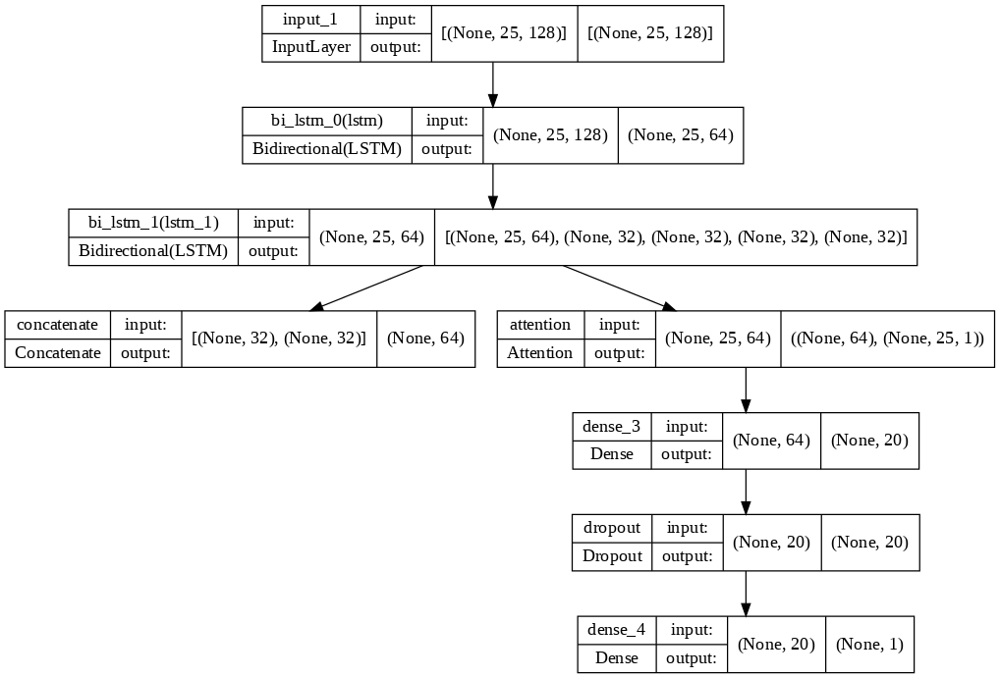

In [ ]:
keras.utils.plot_model(model, show_shapes=True, dpi=90)

In [ ]:
!pip install tensorflow_addons

     |████████████████████████████████| 1.1 MB 6.8 MB/s 


In [ ]:
import tensorflow_addons as tfa

In [ ]:
METRICS = [
      keras.metrics.TruePositives(name='tp'),
      keras.metrics.FalsePositives(name='fp'),
      keras.metrics.TrueNegatives(name='tn'),
      keras.metrics.FalseNegatives(name='fn'), 
      keras.metrics.BinaryAccuracy(name='accuracy'),
      keras.metrics.Precision(name='precision'),
      keras.metrics.Recall(name='recall'),
      keras.metrics.AUC(name='auc'),
      tfa.metrics.CohenKappa(num_classes=2, sparse_labels=True,name='CohenKappa')
]

model.compile(loss='binary_crossentropy', optimizer='adam', metrics=METRICS)


In [ ]:
# X_train = reviews['Processed_Reviews_token']
# y_train = reviews['Ratings'].apply(lambda x: 0 if x == 1 or x == 2 or x == 3 else 1)

In [ ]:
# X_train = pad_sequences(reviews['Processed_Reviews_token'], maxlen=MAX_LEN)
# y_train = reviews['Ratings'].apply(lambda x: 0 if x == 1 or x == 2 or x == 3 else 1)

In [ ]:
import numpy as np
from sklearn.model_selection import train_test_split

In [ ]:
X = sequences_embedd
y = reviews['Ratings'].apply(lambda x: 0 if x == 1 or x == 2 or x == 3 else 1)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)
X_train = tf.convert_to_tensor(X_train, dtype = "float32")
X_test = tf.convert_to_tensor(X_test, dtype = "float32")

In [ ]:
sum(y_train==0)/(sum(y_train==0)+sum(y_train==1))

0.5476766048885308

In [ ]:
sum(y==0)

3064

In [ ]:
BATCH_SIZE = 100
EPOCHS = 10
history = model.fit(X_train,y_train,
                    batch_size=BATCH_SIZE,
                    epochs=EPOCHS,
                    validation_split=0.2)

Epoch 1/10
30/30 [==============================] - 24s 148ms/step - loss: 0.0276 - tp: 1326.0000 - fp: 19.0000 - tn: 1623.0000 - fn: 10.0000 - accuracy: 0.9903 - precision: 0.9859 - recall: 0.9925 - auc: 0.9994 - CohenKappa: 0.9803 - val_loss: 1.2084 - val_tp: 271.0000 - val_fp: 64.0000 - val_tn: 333.0000 - val_fn: 77.0000 - val_accuracy: 0.8107 - val_precision: 0.8090 - val_recall: 0.7787 - val_auc: 0.8508 - val_CohenKappa: 0.6190
Epoch 2/10
30/30 [==============================] - 1s 44ms/step - loss: 0.0176 - tp: 1334.0000 - fp: 13.0000 - tn: 1629.0000 - fn: 2.0000 - accuracy: 0.9950 - precision: 0.9903 - recall: 0.9985 - auc: 0.9995 - CohenKappa: 0.9898 - val_loss: 1.3614 - val_tp: 262.0000 - val_fp: 56.0000 - val_tn: 341.0000 - val_fn: 86.0000 - val_accuracy: 0.8094 - val_precision: 0.8239 - val_recall: 0.7529 - val_auc: 0.8415 - val_CohenKappa: 0.6151
Epoch 3/10
30/30 [==============================] - 1s 44ms/step - loss: 0.0440 - tp: 1317.0000 - fp: 21.0000 - tn: 1621.0000 - f

In [ ]:
## Making predictions on our model
prediction = model.predict(X_test)
y_pred = (prediction > 0.5)

              precision    recall  f1-score   support

           0       0.83      0.78      0.81      1025
           1       0.74      0.80      0.77       810

    accuracy                           0.79      1835
   macro avg       0.79      0.79      0.79      1835
weighted avg       0.79      0.79      0.79      1835

CohenKappa score:  0.578199957609536


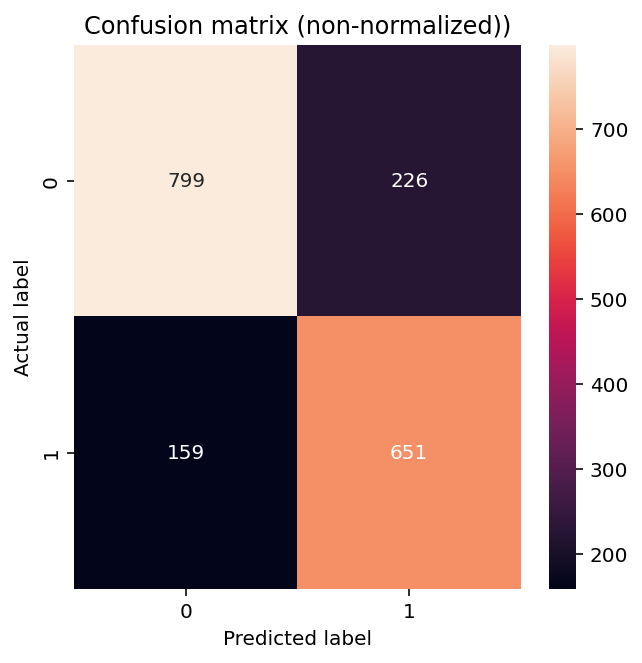

In [ ]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import (classification_report,
                             confusion_matrix,
                             roc_auc_score,
                             cohen_kappa_score)
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

report = classification_report(y_test, y_pred)
print(report)
print('CohenKappa score: ', cohen_kappa_score(y_test, y_pred))


def plot_cm(labels, predictions, p=0.5):
    cm = confusion_matrix(labels, predictions)
    plt.figure(figsize=(5, 5))
    sns.heatmap(cm, annot=True, fmt="d")
    plt.title("Confusion matrix (non-normalized))")
    plt.ylabel("Actual label")
    plt.xlabel("Predicted label")


plot_cm(y_test, y_pred)

In [ ]:
print(cohen_kappa_score(y_test, y_pred))

0.6038560625939267


In [ ]:
cm = confusion_matrix(y_test, y_pred)
tn, fp, fn, tp = cm.ravel()

p_0 = (tn+tp)/(tn+fp+fn+tp)
P_a = ((tn+fp)/(tn+fp+fn+tp))*((tn+fn)/(tn+fp+fn+tp))
P_b = ((fn+tp)/(tn+fp+fn+tp))*((fp+tp)/(tn+fp+fn+tp))
pe = P_a + P_b

κ = (p_0-pe)/(1-pe)
print('κ: ',κ)

κ:  0.5781999576095361


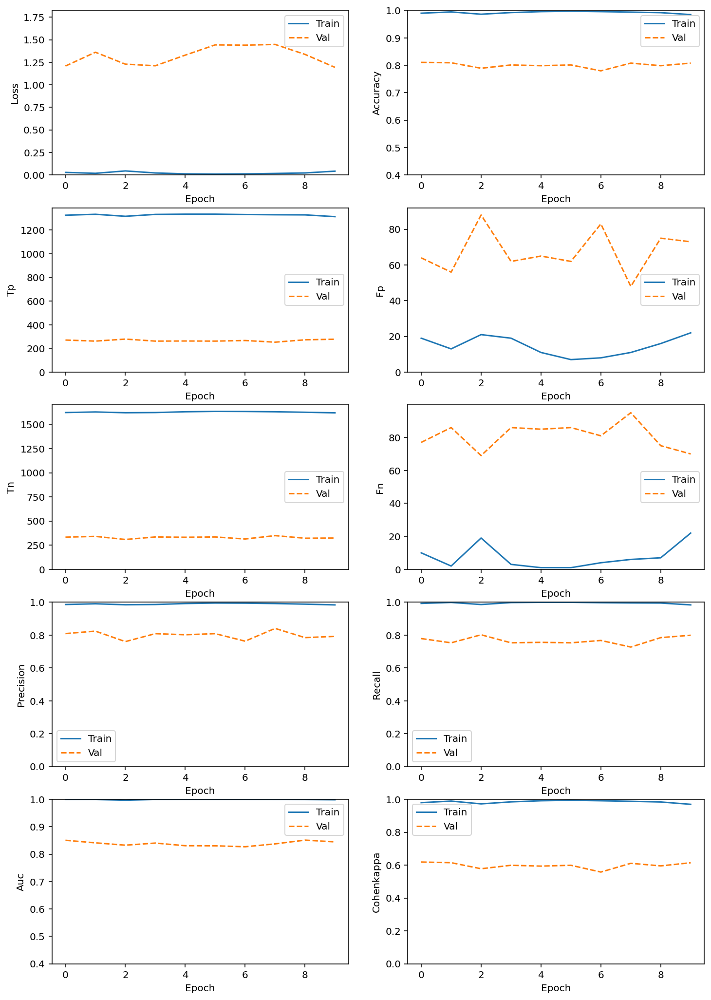

In [ ]:

colors = plt.rcParams["axes.prop_cycle"].by_key()["color"]
mpl.rcParams["figure.figsize"] = (12, 18)

def plot_metrics(history):
    metrics = [
        "loss", "accuracy",
        "tp", "fp", "tn", "fn",
        "precision", "recall",
        "auc", "CohenKappa"
    ]
    for n, metric in enumerate(metrics):
        name = metric.replace("_", " ").capitalize()
        plt.subplot(5, 2, n + 1)
        plt.plot(
            history.epoch,
            history.history[metric],
            color=colors[0],
            label="Train",
        )
        plt.plot(
            history.epoch,
            history.history["val_" + metric],
            color=colors[1],
            linestyle="--",
            label="Val",
        )
        plt.xlabel("Epoch")
        plt.ylabel(name)
        if metric == "loss":
            plt.ylim([0, plt.ylim()[1] * 1.2])
        elif metric == "accuracy":
            plt.ylim([0.4, 1])
        elif metric == "fn":
            plt.ylim([0, plt.ylim()[1]])
        elif metric == "fp":
            plt.ylim([0, plt.ylim()[1]])
        elif metric == "tn":
            plt.ylim([0, plt.ylim()[1]])
        elif metric == "tp":
            plt.ylim([0, plt.ylim()[1]])
        elif metric == "precision":
            plt.ylim([0, 1])
        elif metric == "recall":
            plt.ylim([0, 1])
        elif metric == "auc":
            plt.ylim([0.4, 1])
        else:
            plt.ylim([0, 1])

        plt.legend()

plot_metrics(history)

In [ ]:
def getreview(text):
  # очищаем
  text = clean_text(text) 
  # переводим данные в датасет tf
  ds1 = tf.data.Dataset.from_tensor_slices(pd.DataFrame([text]))
  # токенизируем данные на уже существующем словаре
  text_vector_ds1 = ds1.batch(1024).prefetch(AUTOTUNE).map(vectorize_layer).unbatch()
  sequences1 = list(text_vector_ds1.as_numpy_iterator())
  # применяем функцию word2vec
  sequences1 = sequences_embedd_func(sequences1)
  # получаем предсказание модели
  result = model.predict(sequences1)
  if result[[0]] < 0.5:
    print('Отзыв отрицательный')
  else:
    print('Отзыв положительный')

In [ ]:
text = '''В общем, пылесос не вау'''
getreview(text)

Отзыв отрицательный


In [ ]:
text = '''В общем, пылесос просто вау'''
getreview(text)

Отзыв отрицательный


# Визуализации

In [ ]:
# pattern1 = re.compile(r'\\n(' + r')') 
# pattern2 = re.compile(r'\b(' + r'|'.join(stop_words) + r')\b\s|[^\w\s]' + r'|[0-9]') 
# pattern3 = re.compile(r'(^|\s)[a-z](\s|$)')

# reviews['ReviewClean'] = reviews.Review.apply(lambda text: pattern1.sub('', text))
# reviews['ReviewClean'] = reviews.ReviewClean.apply(lambda text: pattern2.sub('', text))
# reviews['ReviewClean'] = reviews.ReviewClean.apply(lambda text: pattern3.sub('', text))

# reviews['ReviewClean'] = reviews['ReviewClean'].apply(lambda x: " ".join([y.lemma_ for y in spacy_ru(x)]))

In [ ]:
# convention_df = pd.DataFrame()
# convention_df["Class"] = reviews['Ratings'].apply(lambda x: "Bad comment" if x == 1 or x == 2 or x == 3 else "Good comment")
# convention_df["FinalReview"] = reviews['ReviewClean']

In [ ]:
convention_df = pd.DataFrame()
convention_df["Class"] = reviews['Ratings'].apply(lambda x: "Bad comment" if x == 1 or x == 2 or x == 3 else "Good comment")
convention_df["FinalReview"] = reviews['Processed_Reviews']

In [ ]:
corpus = st.CorpusFromPandas(convention_df,
                             category_col="Class",
                             text_col="FinalReview",
                             nlp=spacy_ru).build()

In [ ]:
html = st.produce_scattertext_explorer(
    corpus,
    category="Good comment",
    category_name="Good comment",
    not_category_name="Bad comment",
    width_in_pixels=1000,
    metadata=corpus.get_df()['FinalReview']
)

In [ ]:
from IPython.display import IFrame
from IPython.core.display import display, HTML
import sys

IN_COLAB = "google.colab" in sys.modules
print(IN_COLAB)

True


In [ ]:
if IN_COLAB:
    display(HTML("<style>.container { width:98% !important; }</style>"))
    display(HTML(html))

In [ ]:
# from yellowbrick.text import TSNEVisualizer
# # from yellowbrick.datasets import load_hobbies

# # Load the data and create document vectors
# corpus = convention_df["FinalReview"]
# tfidf = TfidfVectorizer()

# X = tfidf.fit_transform(corpus)

# clusters = KMeans(n_clusters=5)
# clusters.fit(X)

# tsne = TSNEVisualizer()
# tsne.fit(X, ["c{}".format(c) for c in clusters.labels_])
# tsne.show()

In [ ]:
corpus = convention_df["FinalReview"]
tfidf = TfidfVectorizer()
tsne = TSNE(n_components=2, random_state=0)


projections = tfidf.fit_transform(corpus)


clusters = KMeans(n_clusters=5)
clusters.fit(projections)


projectionsTSNE = tsne.fit_transform(projections)

kkk = pd.DataFrame(data=projectionsTSNE[0:,0:])  
clustersviz = pd.Series(clusters.labels_)

VizTable = pd.concat([kkk, convention_df["FinalReview"], clustersviz], axis=1)
VizTable.columns = ['x', 'y',"FinalReview", 'cluster']

fig = px.scatter(
    VizTable, x='x', y='y',
    color='cluster', hover_data=["FinalReview"]
)
fig.show()

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



In [ ]:
from sklearn.metrics import silhouette_samples, silhouette_score


In [ ]:
silhouette_score(projections, clusters.labels_)

0.004398539745259076

For n_clusters = 2 The average silhouette_score is : 0.004328046666291097
For n_clusters = 3 The average silhouette_score is : 0.0044258086241094445
For n_clusters = 4 The average silhouette_score is : 0.0037734552949445295
For n_clusters = 5 The average silhouette_score is : 0.003738912188045669
For n_clusters = 6 The average silhouette_score is : 0.004064736173244861


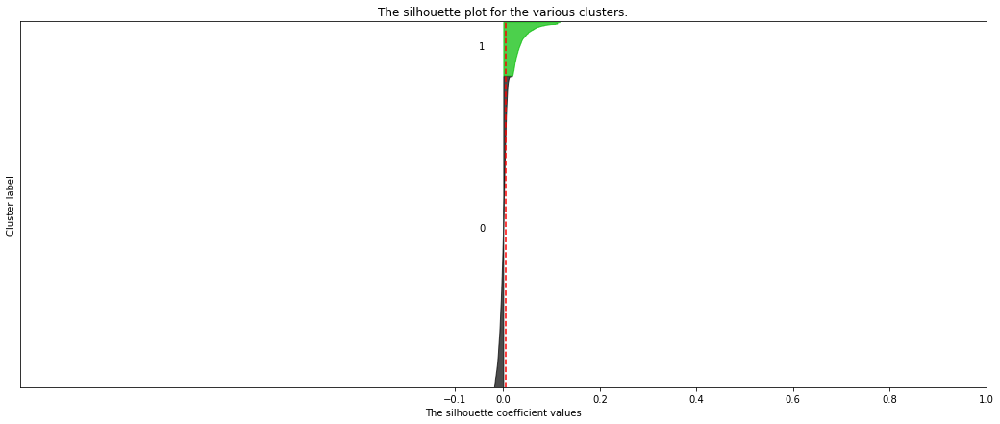

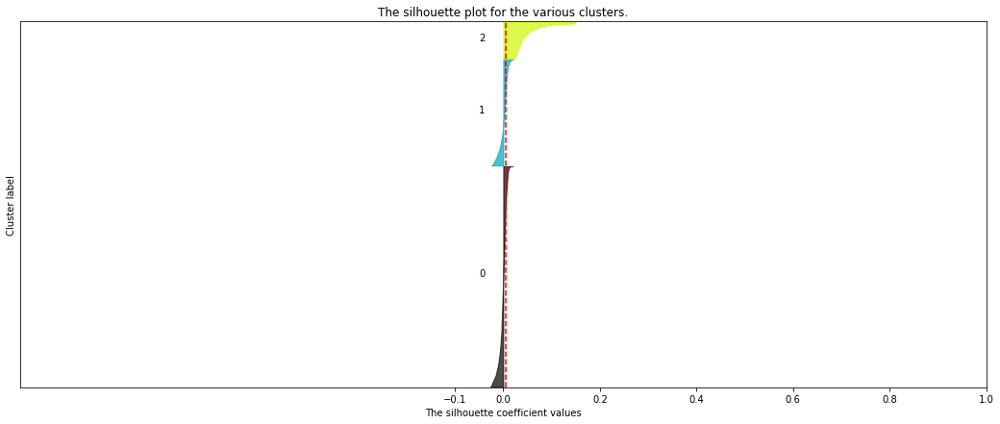

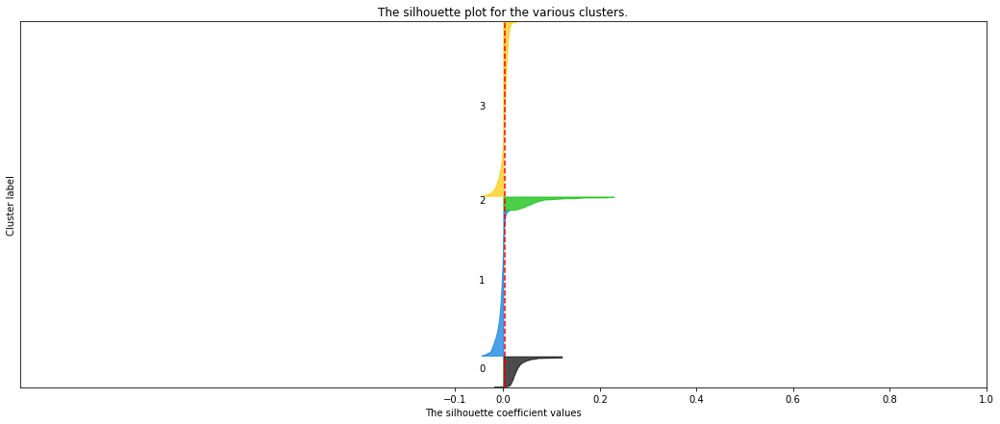

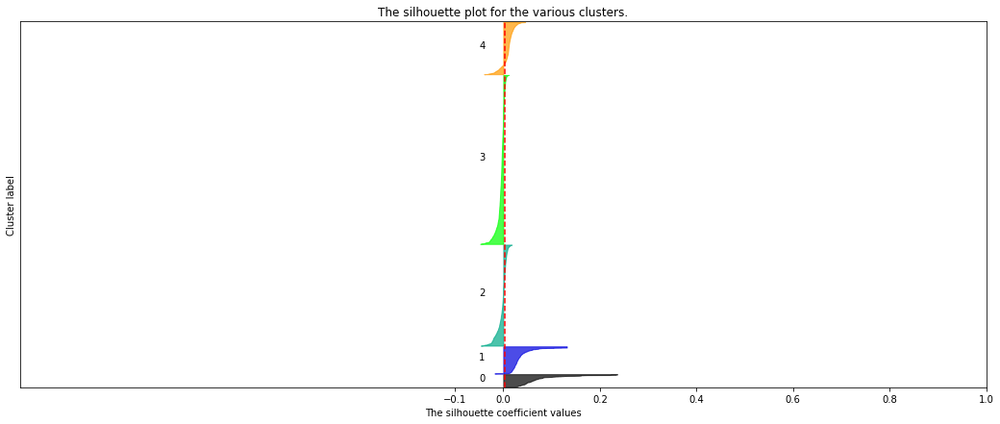

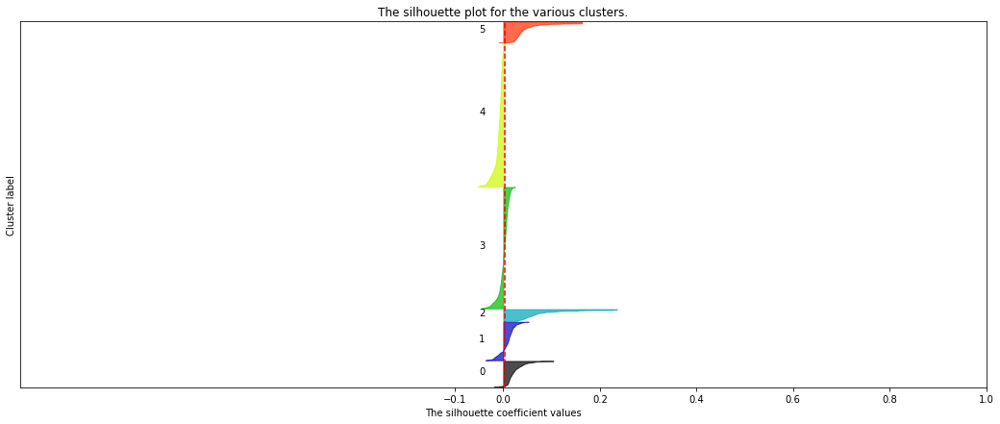

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np


X = VizTable.x
y = VizTable.y

range_n_clusters = [2, 3, 4, 5, 6]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1) = plt.subplots(1)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-1, 1]
    ax1.set_xlim([-1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(projections)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(projections, cluster_labels)
    print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(projections, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])


plt.show()

In [ ]:
# corpus = convention_df["FinalReview"]
# tfidf = TfidfVectorizer()
# tsne = TSNE(n_components=2, random_state=0)
# data = tfidf.fit_transform(corpus)


# umap_2d = umap.UMAP(random_state=0)
# umap_2d.fit(data)

# projections = umap_2d.transform(data)

# clusters = KMeans(n_clusters=5)
# clusters.fit(data)

# kkk = pd.DataFrame(data=projections[0:,0:])  
 
# clustersviz = pd.Series(clusters.labels_)

# VizTable = pd.concat([kkk, convention_df["FinalReview"], clustersviz], axis=1)
# VizTable.columns = ['x', 'y',"FinalReview", 'cluster']
# VizTable


# fig = px.scatter(
#     VizTable, x='x', y='y',
#     color='cluster', hover_data=["FinalReview"]
# )
# fig.show()

#Подсчет слов окружения

In [ ]:
for product in reviews['Product'].unique():
  print (product, 'кол-во отзывов:', len(reviews[reviews['Product'] == product]))

Робот-пылесос  Xiaomi  Mi Robot Vacuum-Mop Essential кол-во отзывов: 542
Вертикальный пылесос Xiaomi Mi Handheld Vacuum Cleaner Pro G10 кол-во отзывов: 4
Бытовой пылесос Samsung SC18M2110SB кол-во отзывов: 6
Робот-пылесос  Xiaomi  Mi Robot Vacuum Mop RU SKV4093GL кол-во отзывов: 183
Бытовой пылесос GARLYN Пылесос BV-300 кол-во отзывов: 3
Робот-полотер  DAIHEART  GAVA811 кол-во отзывов: 9
Робот-пылесос  REDMOND  RV-R640S кол-во отзывов: 127
Робот-пылесос  Polaris  PVCR 1226 кол-во отзывов: 302
Беспроводной пылесос Xiaomi Dreame V11 Vacuum Cleaner кол-во отзывов: 13
Пылесос для дома/ Пылесос вертикальный MARTA MT-1377 ЦИКЛОН 600Вт кол-во отзывов: 6
Робот-пылесос  360  C50-1 кол-во отзывов: 156
Вертикальный пылесос Evolution DX600S кол-во отзывов: 32
Беспроводной пылесос Pioneer 140Вт кол-во отзывов: 53
Робот-пылесос Xiaomi Mijia Robot Vacuum Mop Essential G1 (CN) white кол-во отзывов: 48
Бытовой пылесос Tefal Compact Power XXL TW4871EA кол-во отзывов: 3
Робот-пылесос  Xiaomi  Mijia 2C Sw

In [ ]:
def wordsaround(word, n, product):

  product = product
  product_df = pd.DataFrame()
  product_df["Class"] = reviews['Ratings'].loc[reviews['Product'] == product].apply(lambda x: "Bad comment" if x == 1 or x == 2 or x == 3 else "Good comment")
  product_df["FinalReview"] = reviews['Processed_Reviews'].loc[reviews['Product'] == product]
  product_df = product_df.reset_index()
  product_df = product_df.drop(columns = ['index'])


  a =[]
  for i in range(len(product_df["FinalReview"])):
    a.append(tokenize_ru(product_df["FinalReview"][i]))

  corcodancelist = []
  for i in range(len(product_df["FinalReview"])):
    for j in range(len(a[i])):
      if str(a[i][j]) == word:
        if j-1 >= 0:
          corcodancelist.append(a[i][j-1])
        if j+1 <= len(a[i])-1:
          corcodancelist.append(a[i][j+1])
        if j-2 >= 0:
          corcodancelist.append(a[i][j-2])
        if j+2 <= len(a[i])-1:
          corcodancelist.append(a[i][j+2])          

  res = {}
  res = {i:corcodancelist.count(i) for i in corcodancelist}

  results = pd.DataFrame(res.items(), columns=['words around','count'])
  results['percent'] = results['count']/results['count'].sum()
  # results = results.sort_values(by=['count'], ascending=False)
  results = results.nlargest(n,['percent'])


  y_percent = results['percent']
  y_count = results['count']
  x = results['words around']


  # Creating two subplots
  fig = make_subplots(rows=1, cols=2, specs=[[{}, {}]], shared_xaxes=True,
                      shared_yaxes=False, vertical_spacing=0.001)

  fig.append_trace(go.Bar(
      x=y_percent,
      y=x,
      marker=dict(
          color='rgba(50, 171, 96, 0.6)',
          line=dict(
              color='rgba(50, 171, 96, 1.0)',
              width=1),
      ),
      name='Percentage of total words used with exact word',
      orientation='h',
  ), 1, 1)

  fig.append_trace(go.Scatter(
      x=y_count, y=x,
      mode='lines+markers',
      line_color='rgb(128, 0, 128)',
      name='Count of words used with exact word',
  ), 1, 2)

  fig.update_layout(
      title='Используемые слова с "' + word + '"' + ' для ' + product,
      yaxis=dict(
          showgrid=False,
          showline=False,
          showticklabels=True,
          domain=[0, 0.85],
      ),
      yaxis2=dict(
          showgrid=False,
          showline=True,
          showticklabels=False,
          linecolor='rgba(102, 102, 102, 0.8)',
          linewidth=2,
          domain=[0, 0.85],
      ),
      xaxis=dict(
          zeroline=False,
          showline=False,
          showticklabels=True,
          showgrid=True,
          domain=[0, 0.42],
      ),
      xaxis2=dict(
          zeroline=False,
          showline=False,
          showticklabels=True,
          showgrid=True,
          domain=[0.47, 1],
          side='top',
          dtick=5,
      ),
      legend=dict(x=0.029, y=1.038, font_size=10),
      margin=dict(l=100, r=20, t=70, b=70),
      paper_bgcolor='rgb(248, 248, 255)',
      plot_bgcolor='rgb(248, 248, 255)',
  )

  return fig.show()

In [ ]:
wordsaround('уборка', 15, 'Робот-пылесос  Xiaomi  Mi Robot Vacuum-Mop Essential')

In [ ]:
product = 'Робот-пылесос  Xiaomi  Mi Robot Vacuum-Mop Essential'
word = 'уборка'
n = 15

product_df = pd.DataFrame()
product_df["Class"] = reviews['Ratings'].loc[reviews['Product'] == product].apply(lambda x: "Bad comment" if x == 1 or x == 2 or x == 3 else "Good comment")
product_df["FinalReview"] = reviews['Processed_Reviews'].loc[reviews['Product'] == product]
product_df = product_df.reset_index()
product_df = product_df.drop(columns = ['index'])
# product_df
a =[]
for i in range(len(product_df["FinalReview"])):
  if tokenize_ru(product_df["FinalReview"][i]) != ' ':
    a.append(tokenize_ru(product_df["FinalReview"][i]))

corcodancelist = []
for i in range(len(product_df["FinalReview"])):
  for j in range(len(a[i])):
    if str(a[i][j]) == word:
      if j-1 >= 0:
        corcodancelist.append(a[i][j-1])
      if j+1 <= len(a[i])-1:
        corcodancelist.append(a[i][j+1])
      if j-2 >= 0:
        corcodancelist.append(a[i][j-2])
      if j+2 <= len(a[i])-1:
        corcodancelist.append(a[i][j+2])          

res = {}
res = {i:corcodancelist.count(i) for i in corcodancelist}

results = pd.DataFrame(res.items(), columns=['words around','count'])
results

,words around,count
0,неделя,6
1,начать,4
2,два,5
3,выдавать,1
4,движение,1
...,...,...
412,смачивание,1
413,точнее,1
414,-,1
415,.,1


In [ ]:
results['words around'][96].isspace() 

True